In [ ]:


import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter
import pandas as pd
from scipy.io import savemat
!pip install torch torchvision torchaudio
import torch




In [ ]:


!pip install --pre 'cebra[datasets, integrations]'


import sys

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import joblib as jl
import cebra.datasets
from cebra import CEBRA

from matplotlib.collections import LineCollection
import pandas as pd



In [ ]:


#2. Define the model
max_iterations = 5000
cebra_posdir3_model = CEBRA(model_architecture='offset10-model',
                        batch_size=512,
                        learning_rate=3e-4,
                        temperature=1,
                        output_dimension=3,
                        max_iterations=max_iterations,
                        distance='cosine',
                        conditional='time_delta',
                        device='cuda_if_available',
                        verbose=True,
                        time_offsets=10)


import cebra.models
print(cebra.models.get_options('offset*'))




['offset10-model', 'offset10-model-mse', 'offset5-model', 'offset1-model-mse', 'offset1-model', 'offset1-model-v2', 'offset1-model-v3', 'offset1-model-v4', 'offset1-model-v5', 'offset40-model-4x-subsample', 'offset20-model-4x-subsample', 'offset4-model-2x-subsample', 'offset36-model', 'offset36-model-dropout', 'offset36-model-more-dropout', 'offset40-model', 'offset50-model', 'offset15-model', 'offset20-model', 'offset10-model-mse-tanh', 'offset1-model-mse-tanh', 'offset1-model-mse-clip-1000-1000', 'offset1-model-mse-clip-1000-100', 'offset1-model-mse-clip-1000-50', 'offset1-model-mse-clip-1000-25', 'offset1-model-mse-clip-1000-20', 'offset1-model-mse-clip-1000-15', 'offset1-model-mse-clip-1000-10', 'offset1-model-mse-clip-1000-5', 'offset1-model-mse-clip-1000-1', 'offset1-model-mse-clip-100-1000', 'offset1-model-mse-clip-100-100', 'offset1-model-mse-clip-100-50', 'offset1-model-mse-clip-100-25', 'offset1-model-mse-clip-100-20', 'offset1-model-mse-clip-100-15', 'offset1-model-mse-clip-

In [ ]:


data = np.load('/content/drive/MyDrive/rat_r_day1_grid_modules_1_2_3.npz', allow_pickle=True)
#Load the .npz
#eural_data = cebra.load_data(file="/content/drive/MyDrive/rat_s_grid_modules_1.npz", key="x")
import matplotlib.pyplot as plt
#plt.plot(data['x'],data['y'])
#print(data['x'])
#print(data['y'])
#print(data['z'])
#print(data['t'])
#plt.plot(['spikes_mod1'])
#print(data['spikes_mod1'])
#plt.plot(data['t'],data['x'])

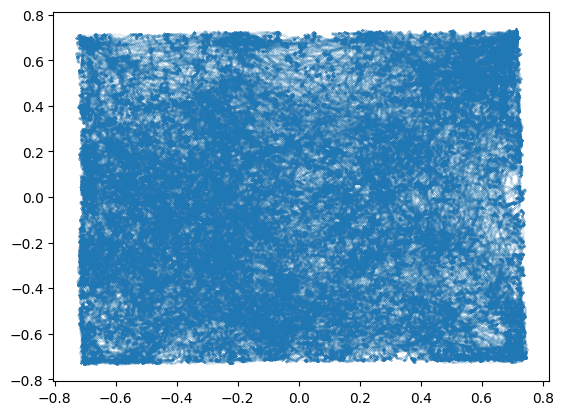

In [ ]:
#Open field --> behavior
#open_field_1, start=7457, end=16045, valid_times=[7457,14778;14890,16045]
start1= 7457.01
end1  = 14778.00
tmin1 = int((start1-data['t'].min())*100)
tmax1 = int((end1-data['t'].min())*100)
start2= 14890.01
end2  = 16045.00
tmin2 = int((start2-data['t'].min())*100)
tmax2 = int((end2-data['t'].min())*100)

plt.scatter(data['x'][np.r_[tmin1:tmax1, tmin2:tmax2]], data['y'][np.r_[tmin1:tmax1, tmin2:tmax2]], s = 0.005)


def linear_combination(data_pos, data_spikes, index0, t0, delta_t):
    # Function to compute the linear combination of positions based on spike times
    n = len(index0)
    index1 = [int(x) for x in index0 + np.ones(n)]
    v = (data_pos[index1]-data_pos[index0])/delta_t * (data_spikes-t0) + data_pos[index0]
    return v

mod = data['spikes_mod1'].item()
pos = {}
tmin = data['t'].min()

# Calculate positions for each cell in the module
# The module contains spikes for different cells, we will extract the positions based on the spikes
for cell, spikes in mod.items():
    spikes = mod[cell]
    openfield = spikes[np.logical_or((spikes<end1) & (spikes>start1), (spikes<end2) & (spikes>start2))]
    nspikes = len(openfield)
    pos[cell] = np.zeros((2, nspikes))
    t0 = np.floor(openfield*100)/100 #2 decimals
    index0 = [int(x) for x in np.floor((t0-tmin)*100)]
    pos[cell][0] = linear_combination(data['x'], openfield, index0, t0, 0.01)
    pos[cell][1] = linear_combination(data['y'], openfield, index0, t0, 0.01)


In [ ]:

positions = np.column_stack([data['x'][np.r_[tmin1:tmax1, tmin2:tmax2]], data['y'][np.r_[tmin1:tmax1, tmin2:tmax2]]])
def discretize(cell_dgm, m=0, M=1, res=30, filt=None, sigma=0.5):
    '''
    Discretize one cell map, returns a 2D-histogram of size (res x res), the grid representing [m, M]^2.
    '''
    h2d = np.histogram2d(cell_dgm[0,:], cell_dgm[1,:], bins=res, range=[[m, M],[m, M]])[0]
    h2d = np.flip(h2d.T, axis=0)
    if filt=="gaussian":
        h2d = gaussian_filter(h2d, sigma=sigma)
    return h2d



0


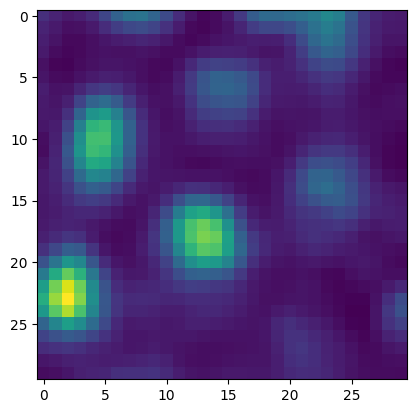

1


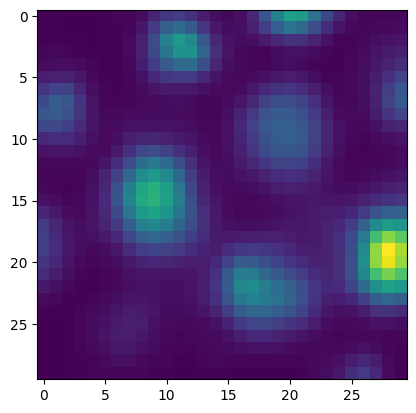

2


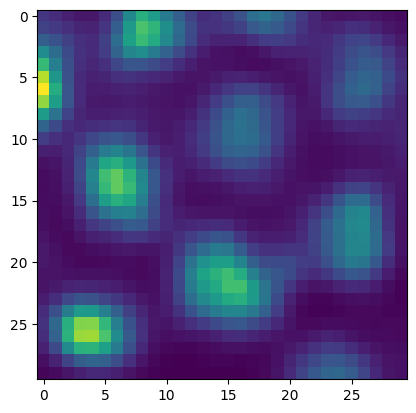

3


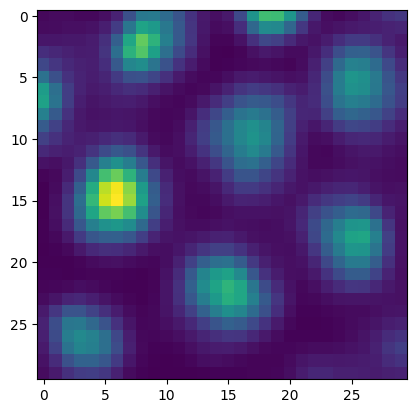

4


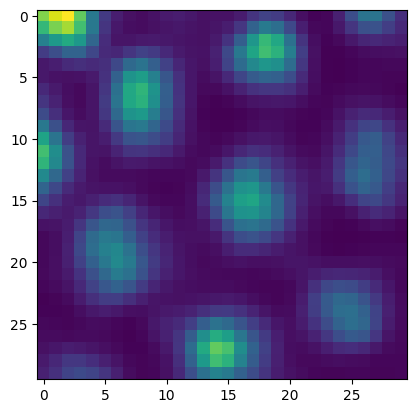

5


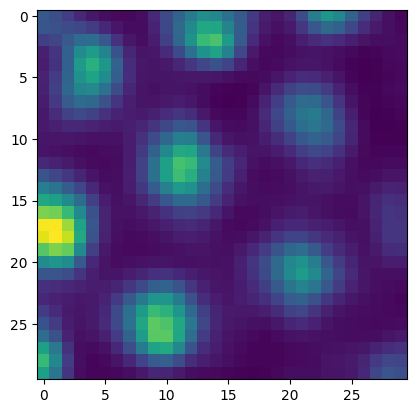

6


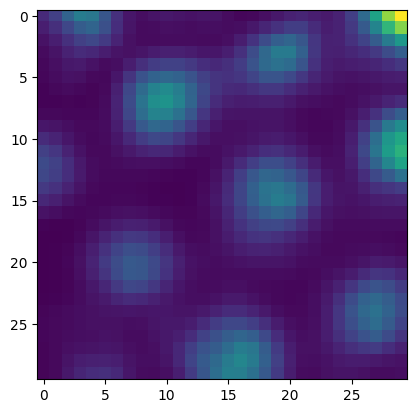

7


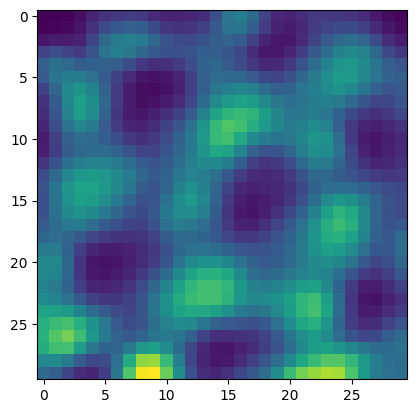

8


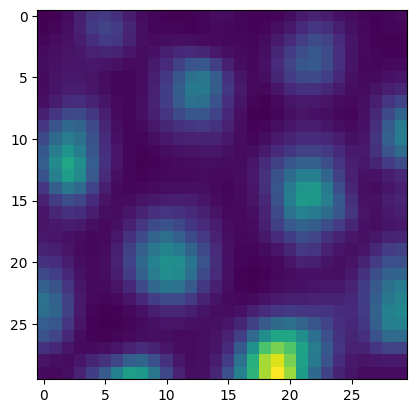

9


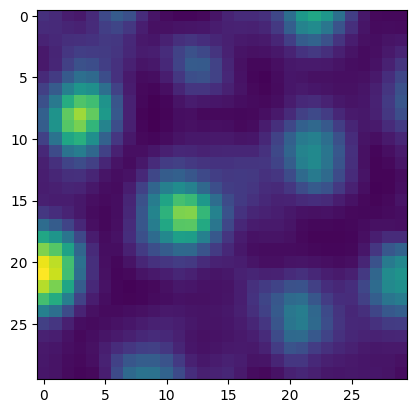

10


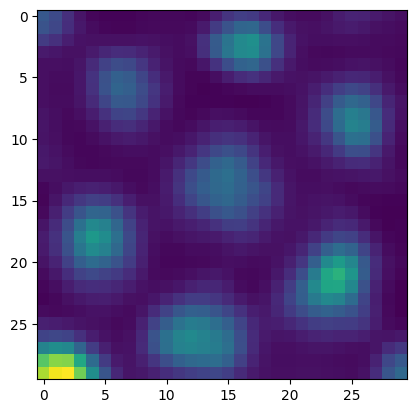

11


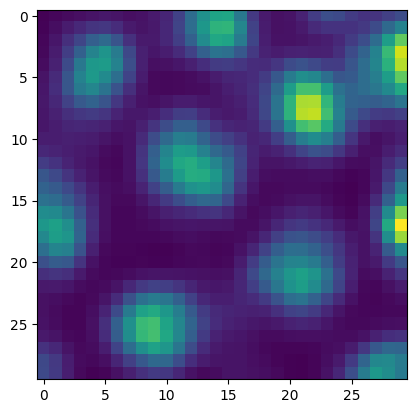

12


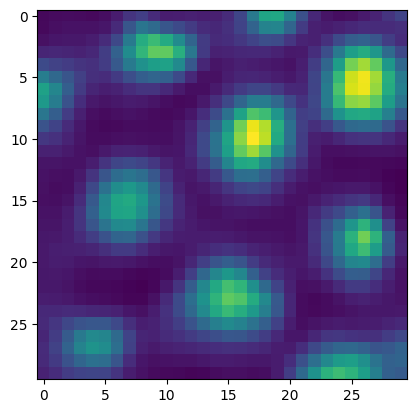

13


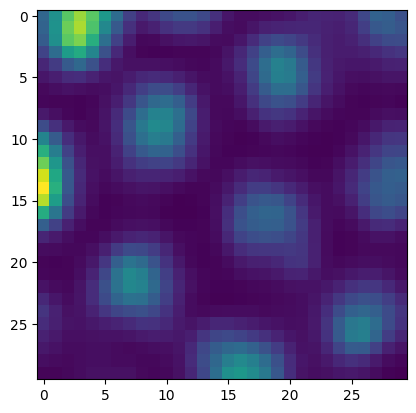

14


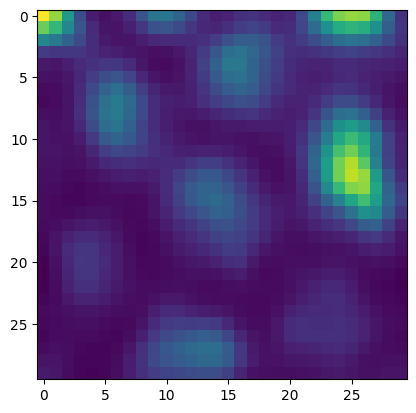

15


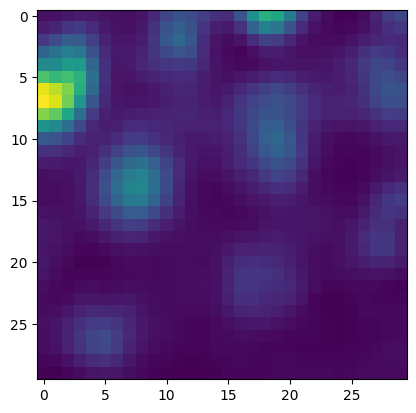

16


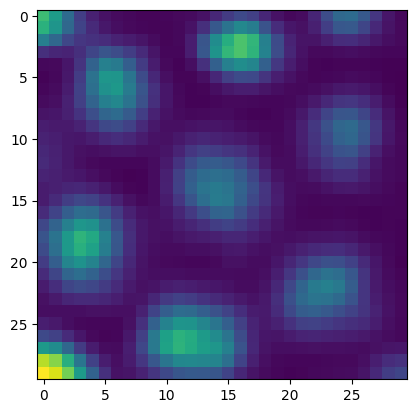

17


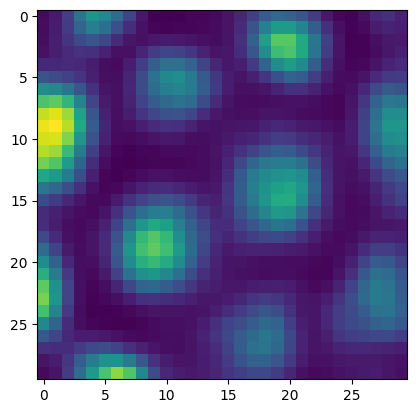

18


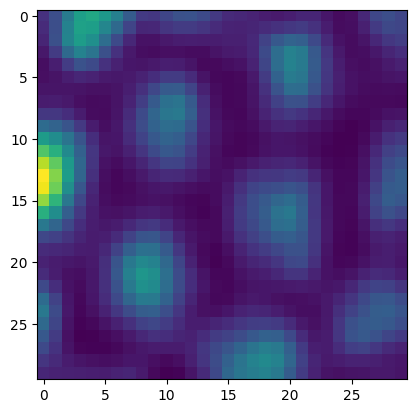

19


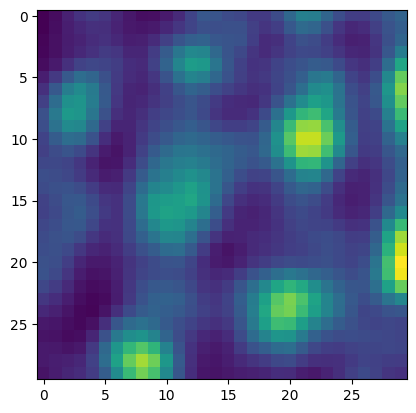

20


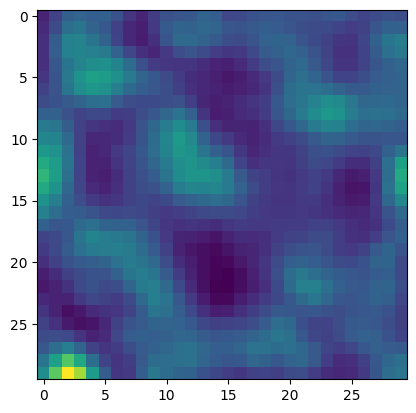

21


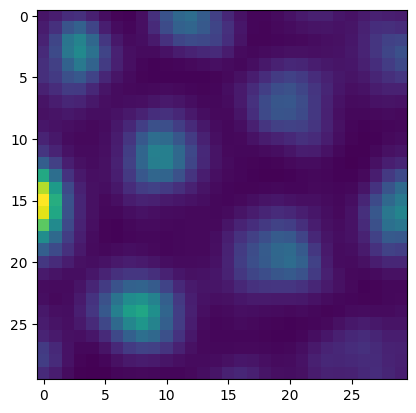

22


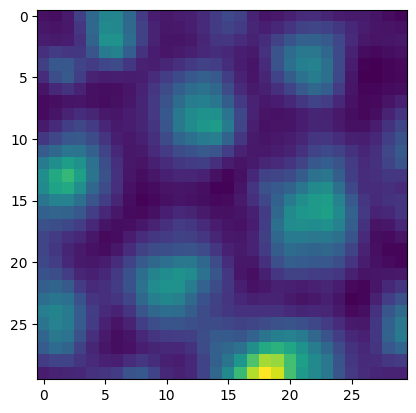

23


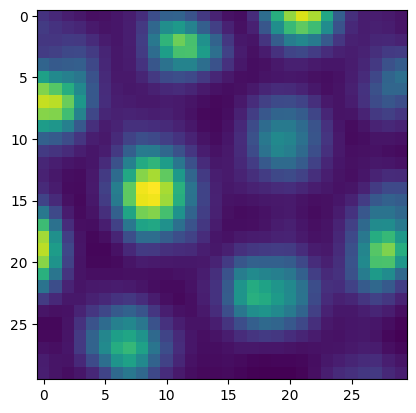

24


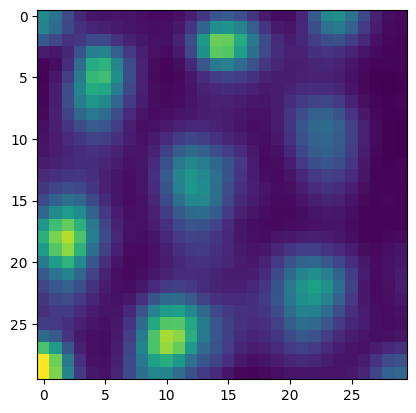

25


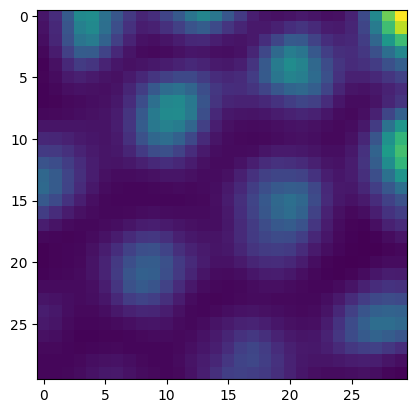

26


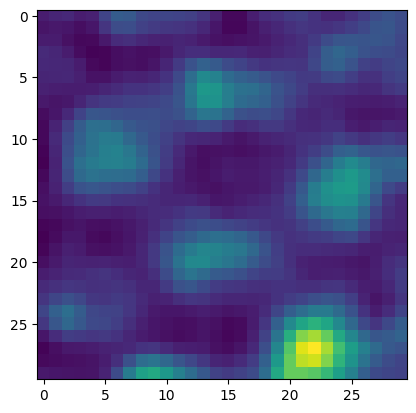

27


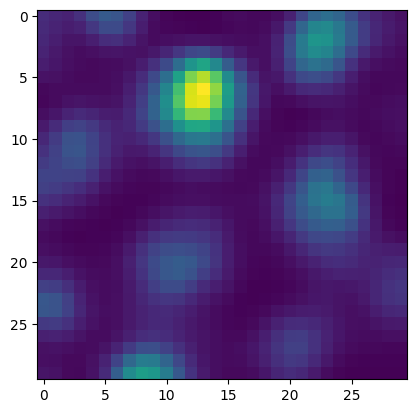

28


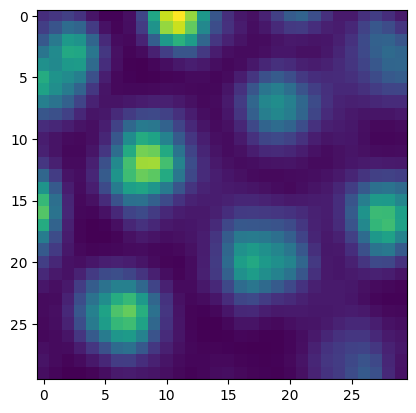

29


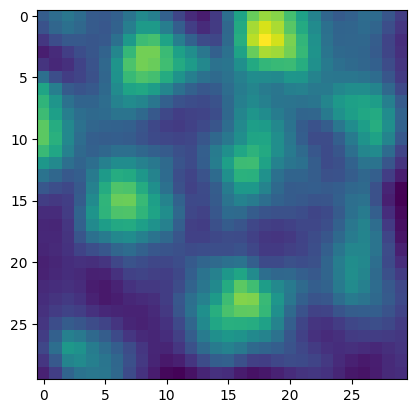

30


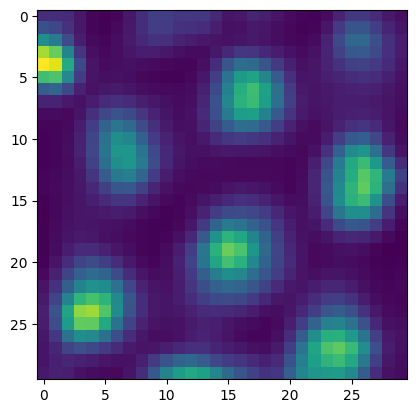

31


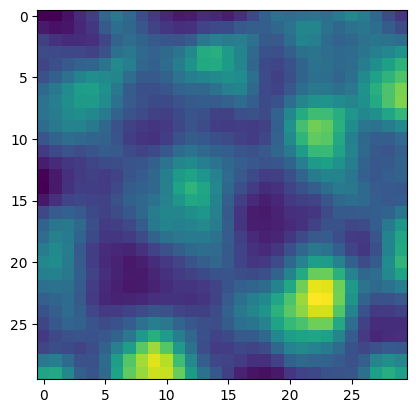

32


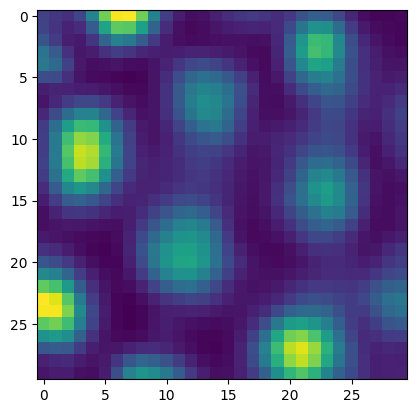

33


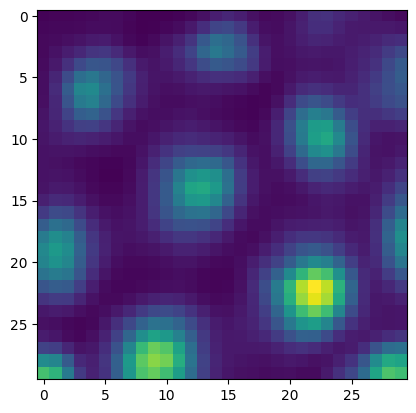

34


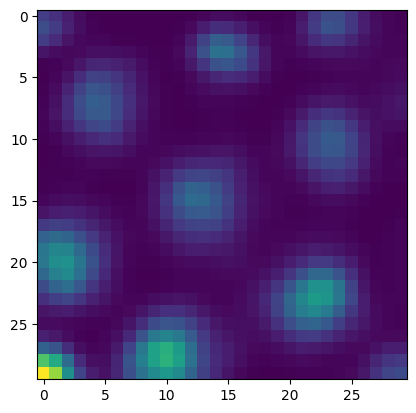

35


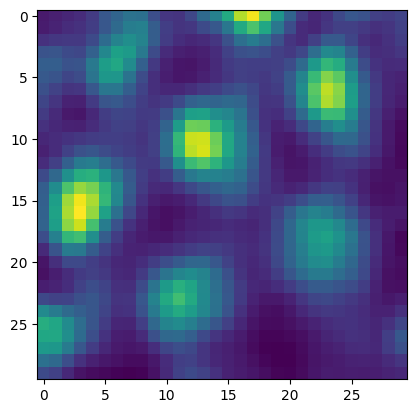

36


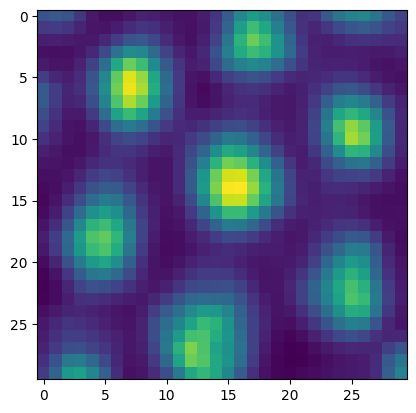

37


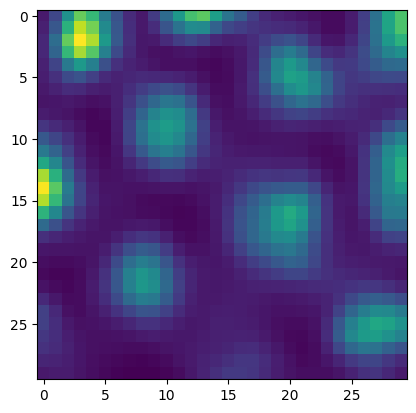

38


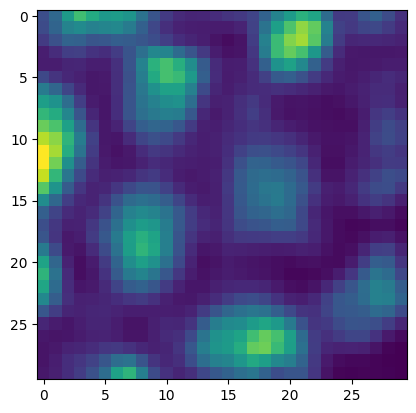

39


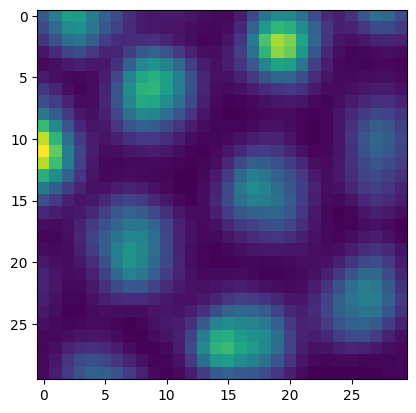

40


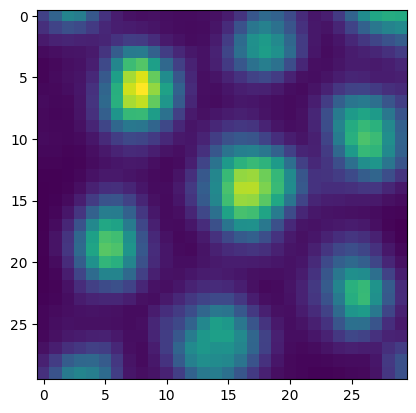

41


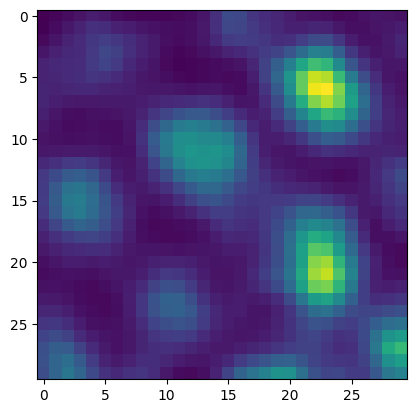

42


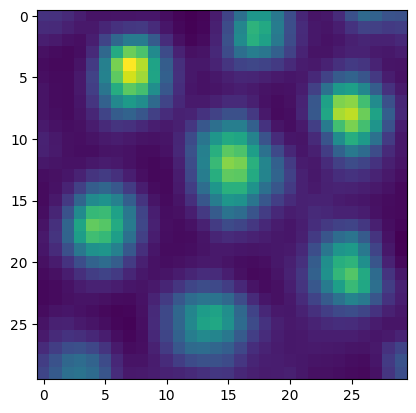

43


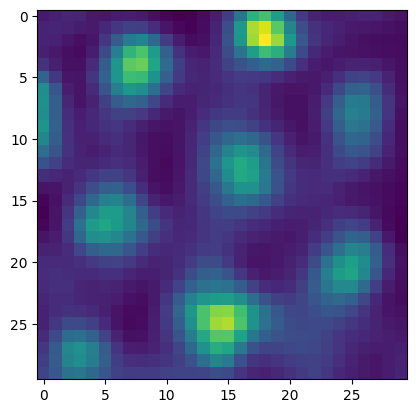

44


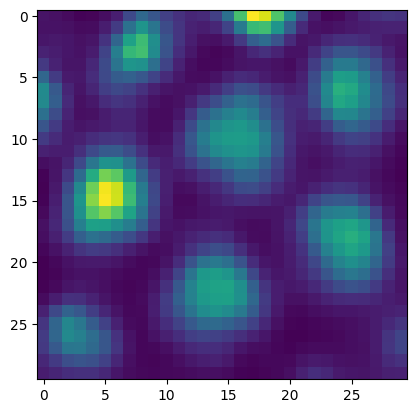

45


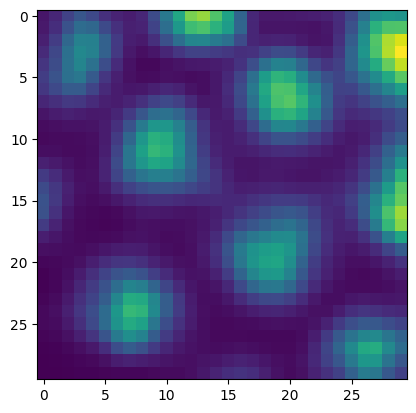

46


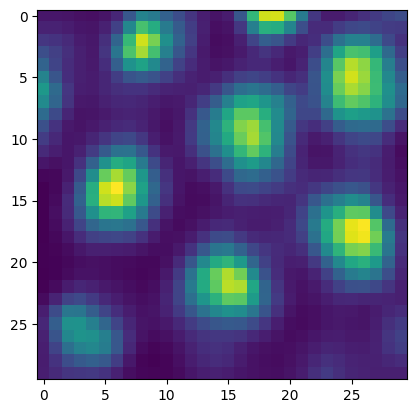

47


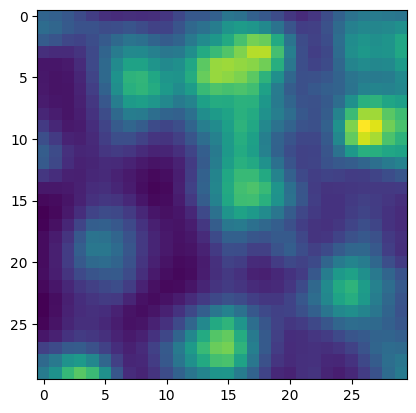

48


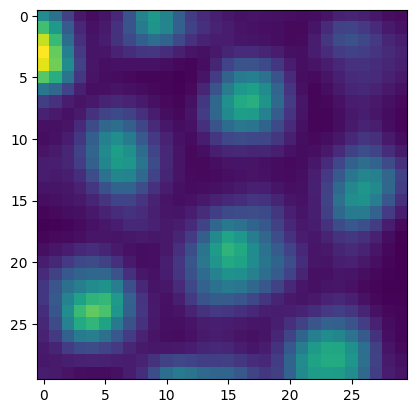

49


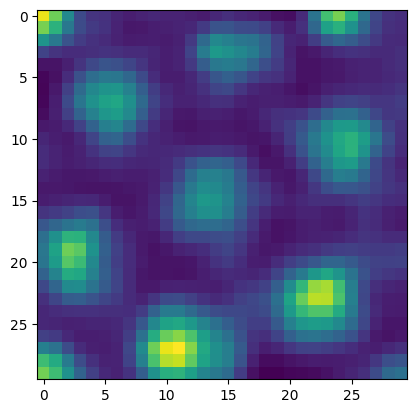

50


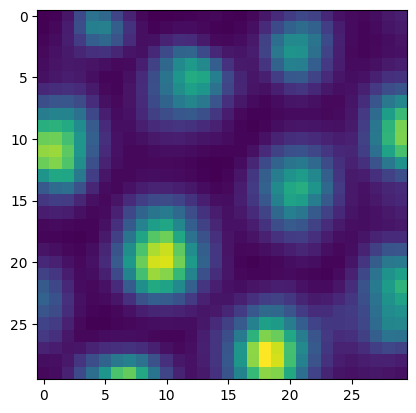

51


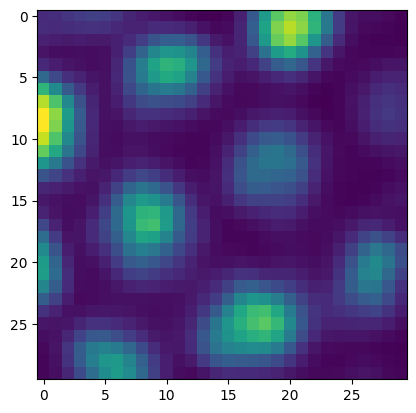

52


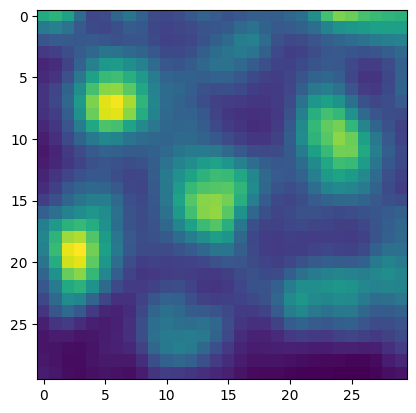

53


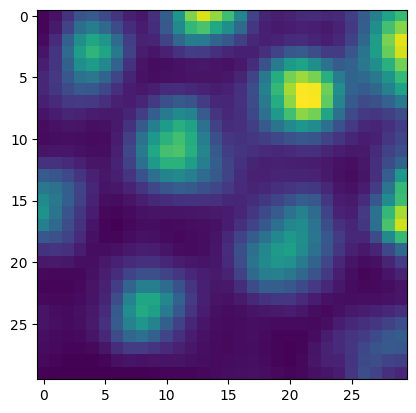

54


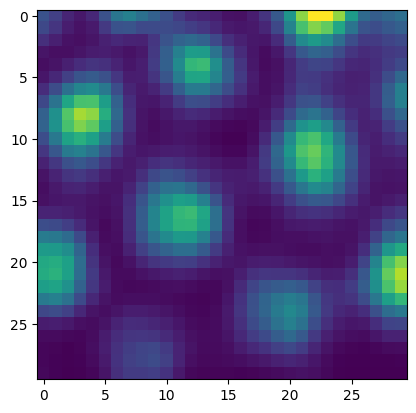

55


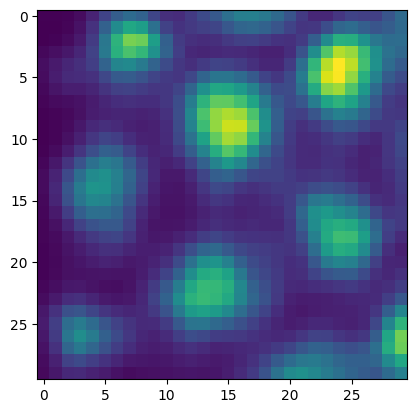

56


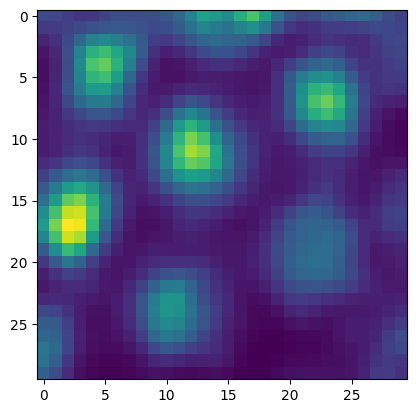

57


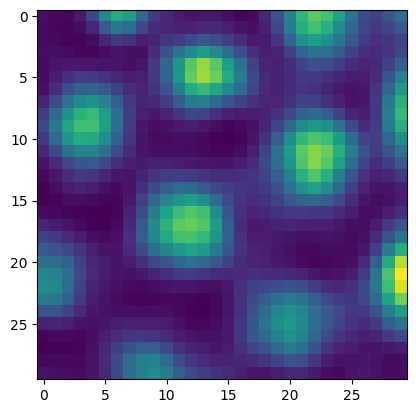

58


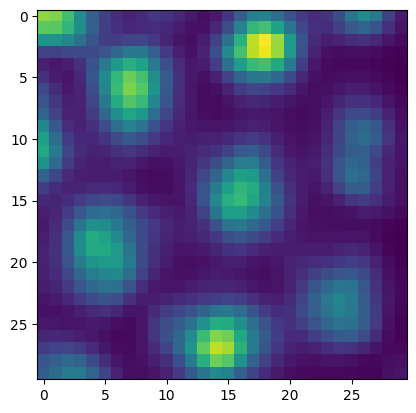

59


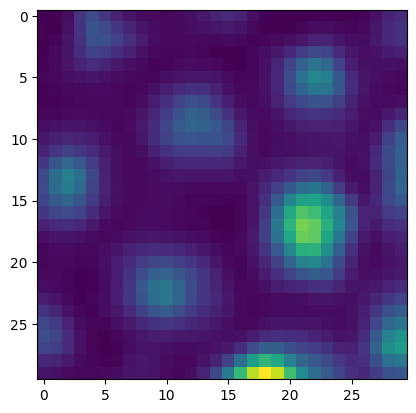

60


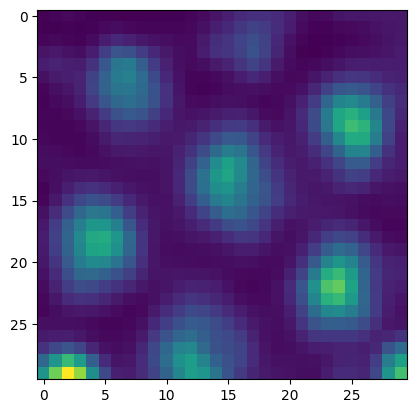

61


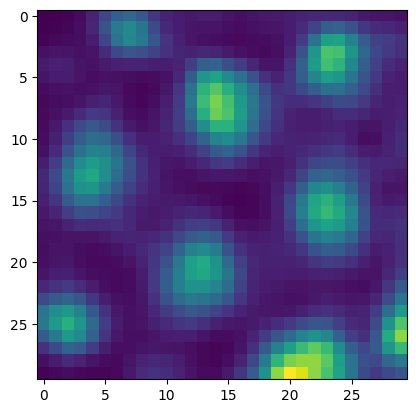

62


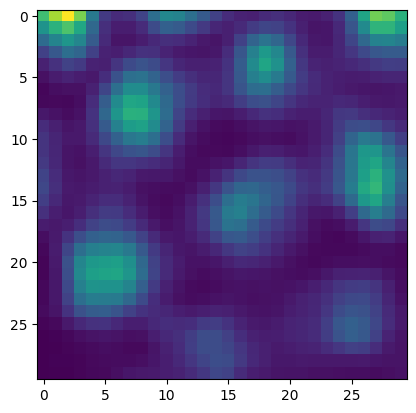

63


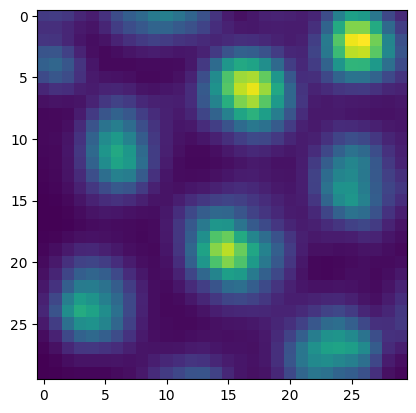

64


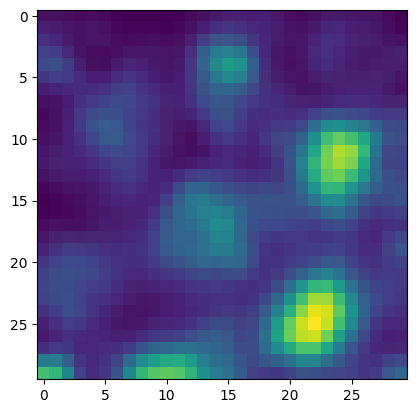

65


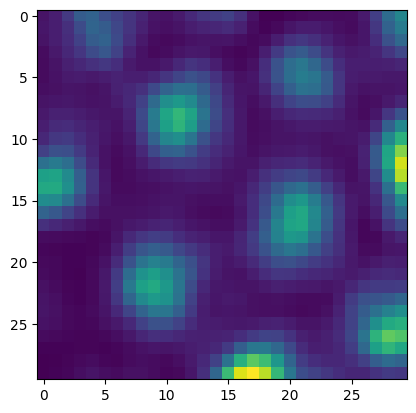

66


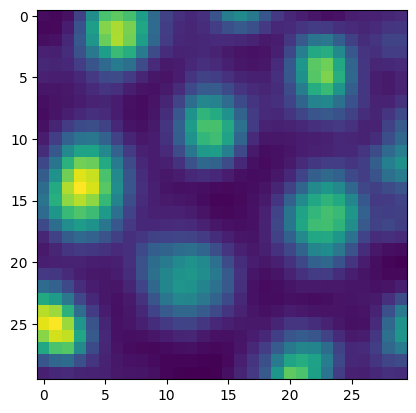

67


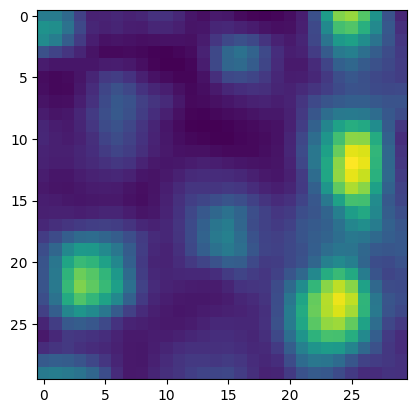

68


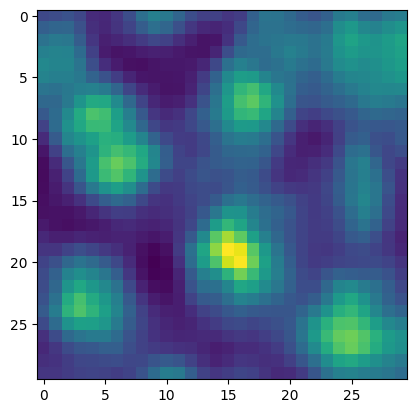

69


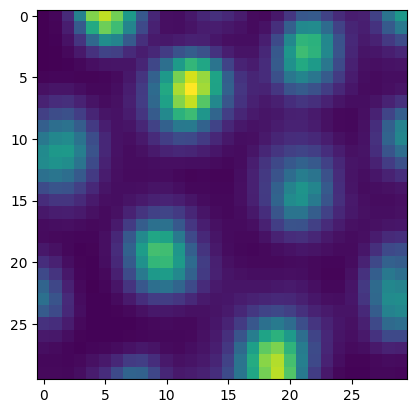

70


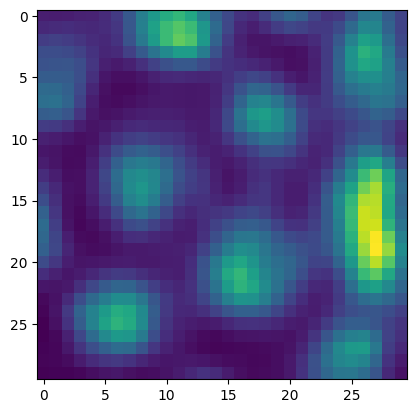

71


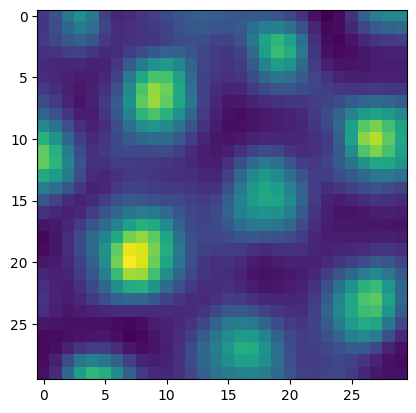

72


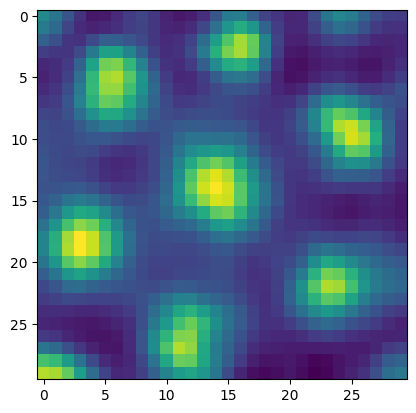

73


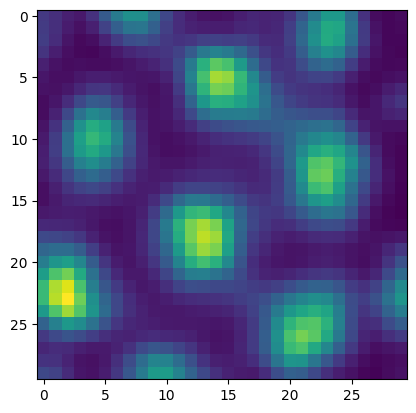

74


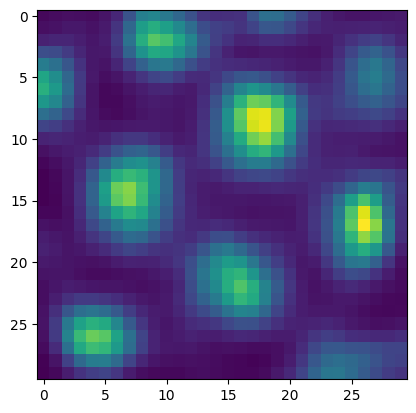

75


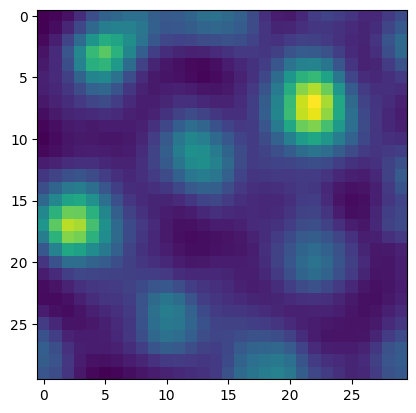

76


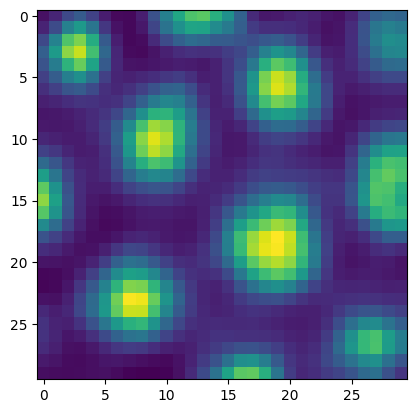

77


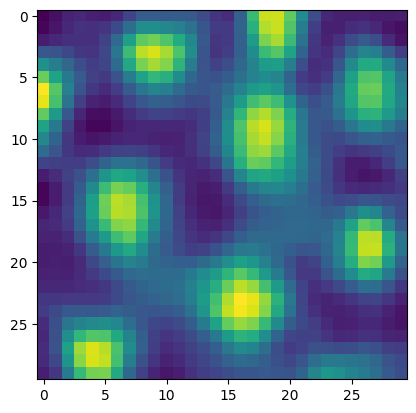

78


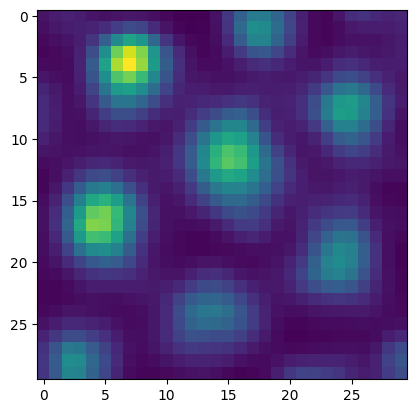

79


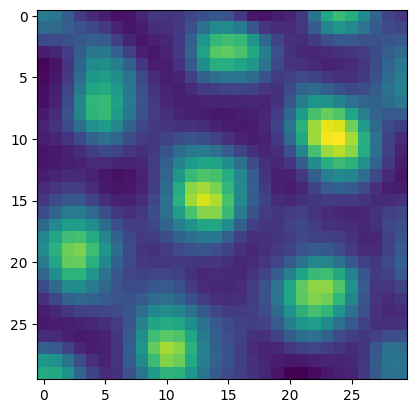

80


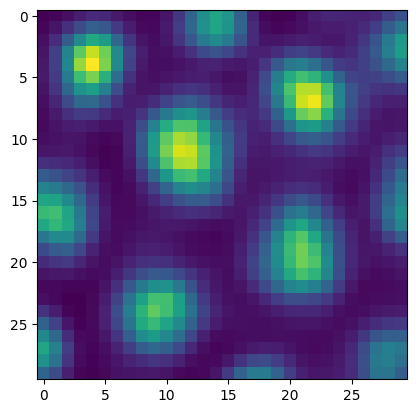

81


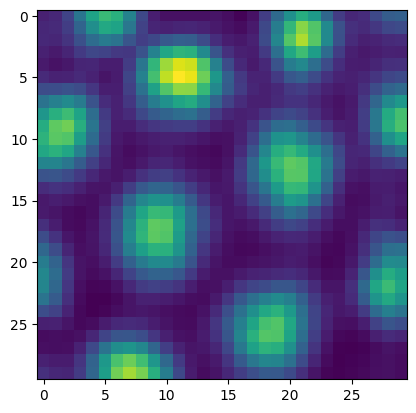

82


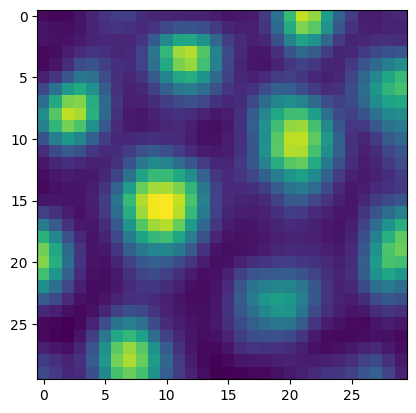

83


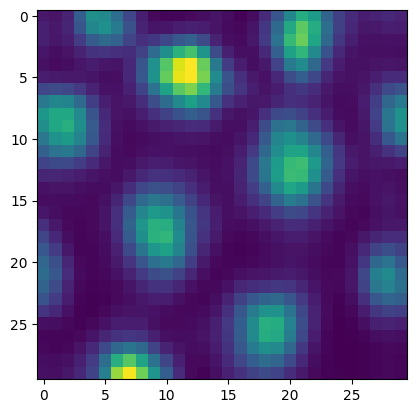

84


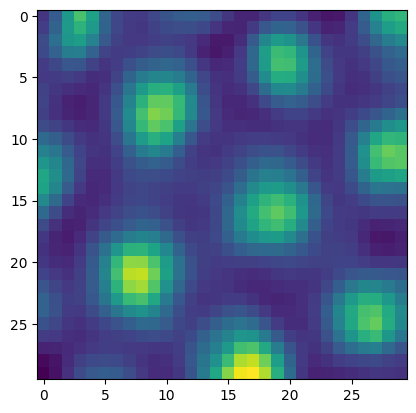

85


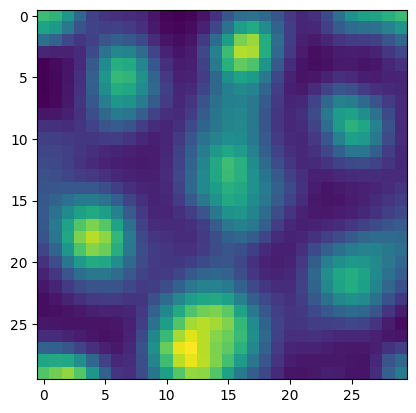

86


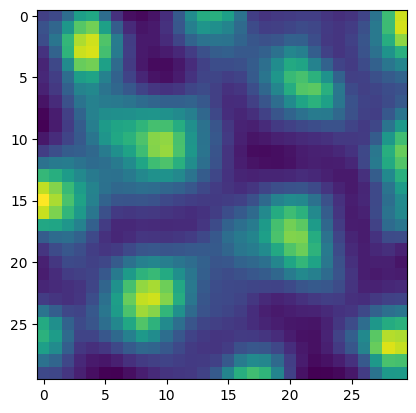

87


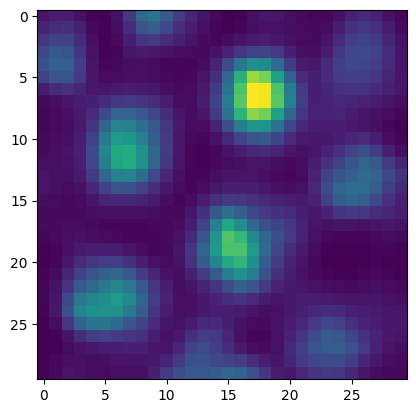

88


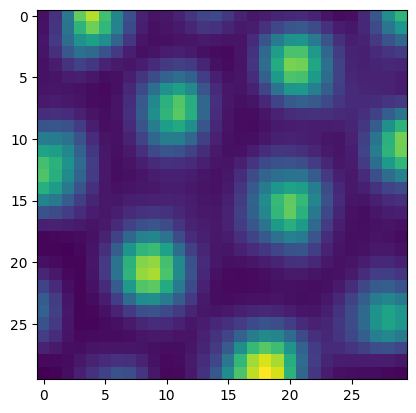

89


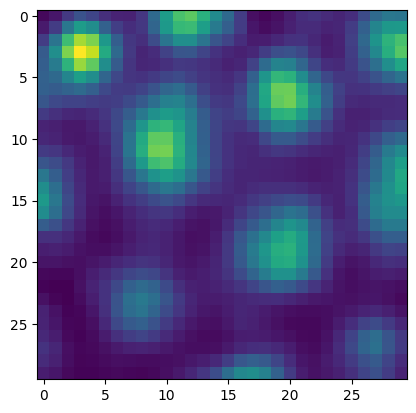

90


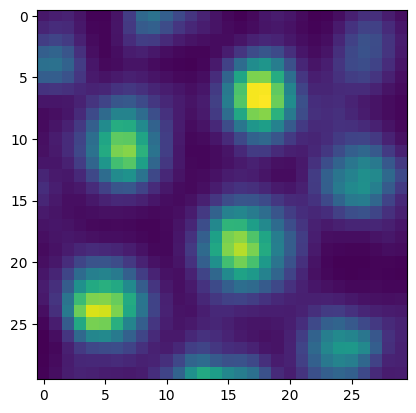

91


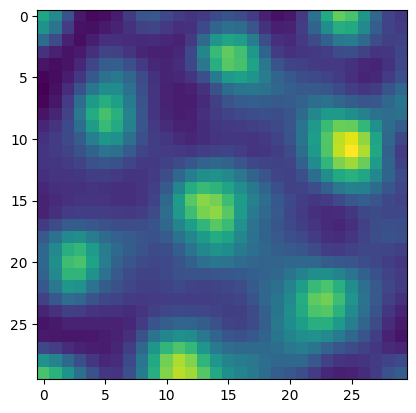

92


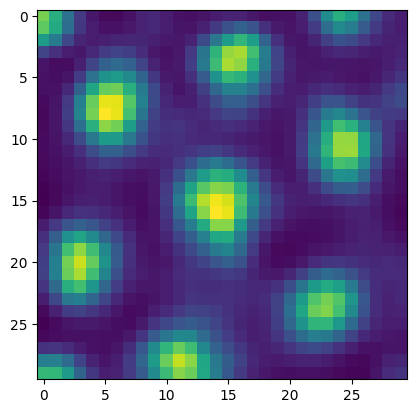

93


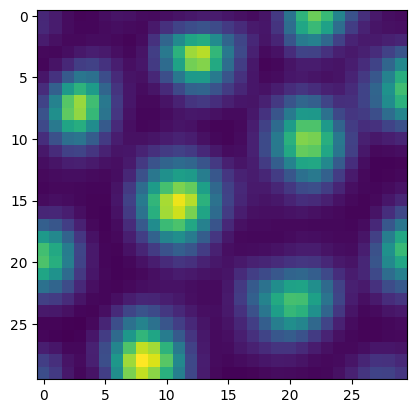

94


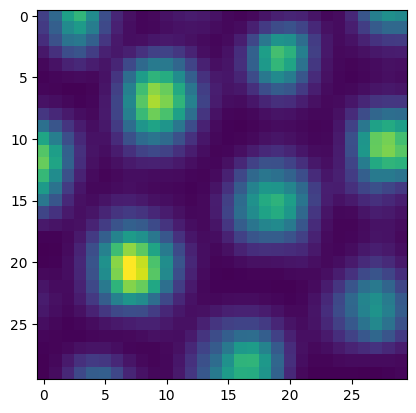

95


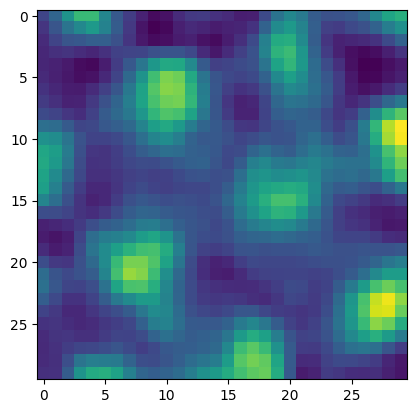

96


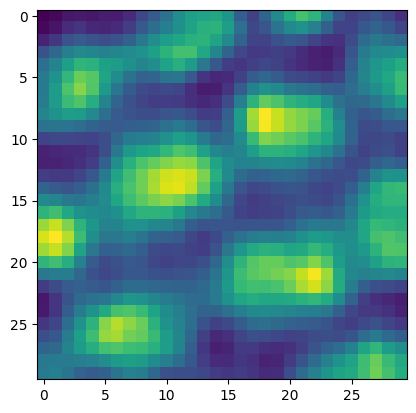

97


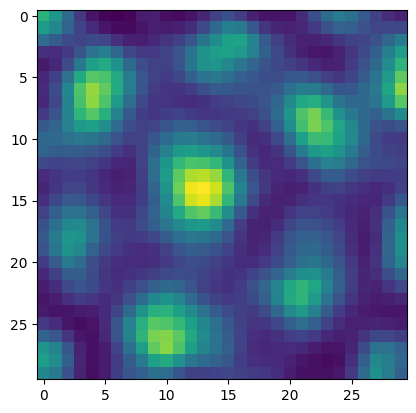

98


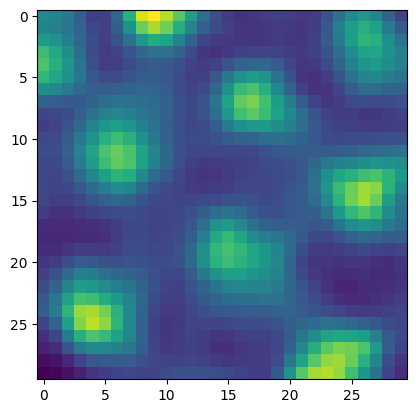

99


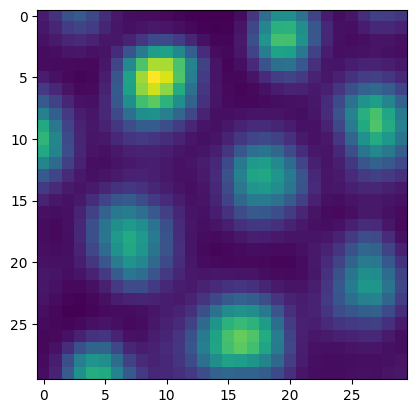

100


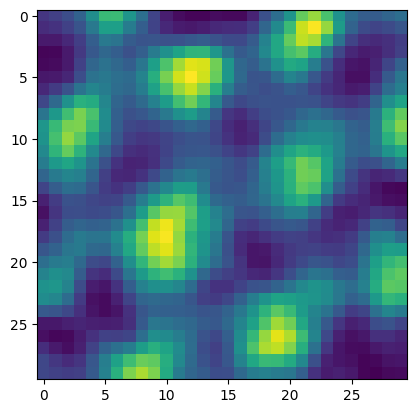

101


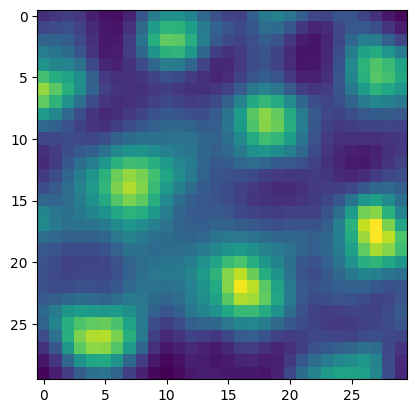

102


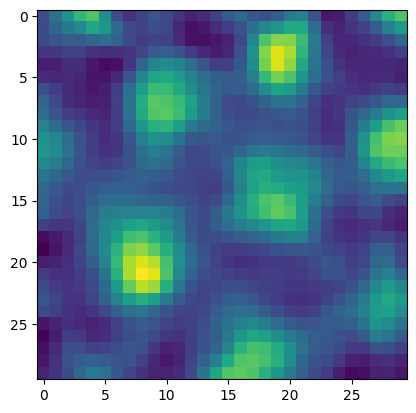

103


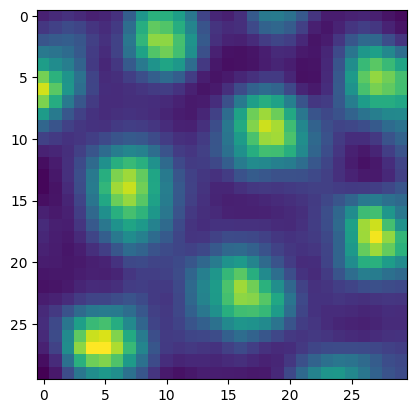

104


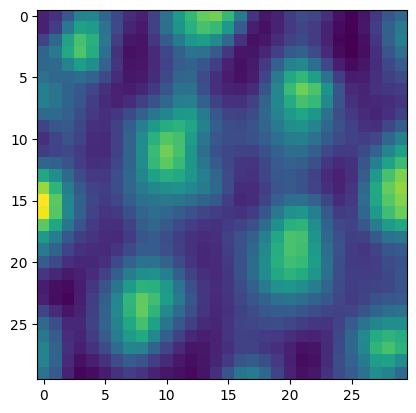

105


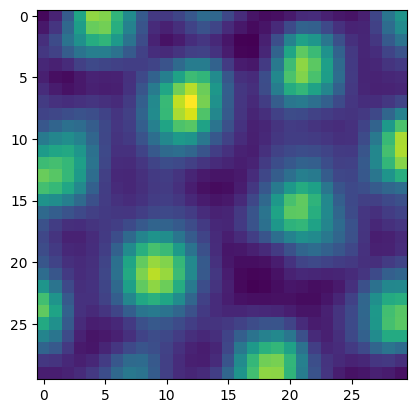

106


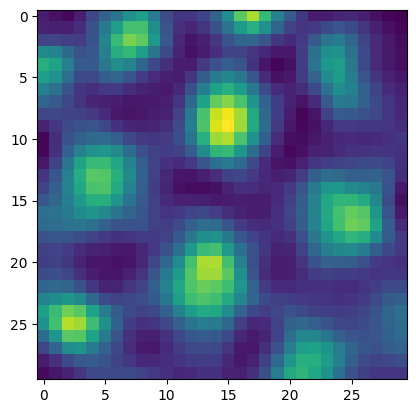

107


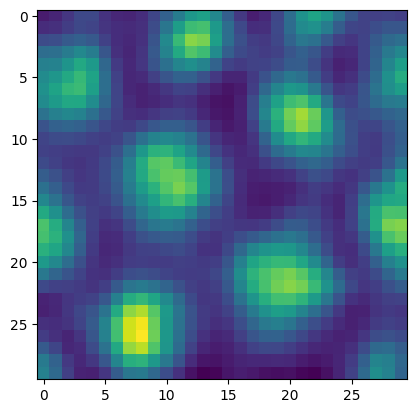

108


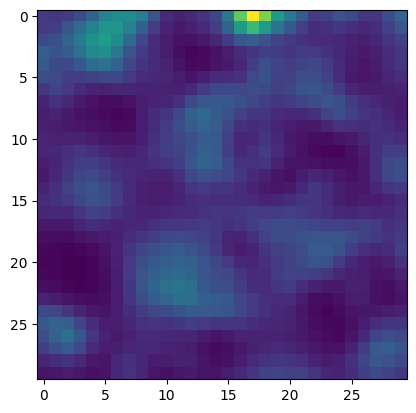

109


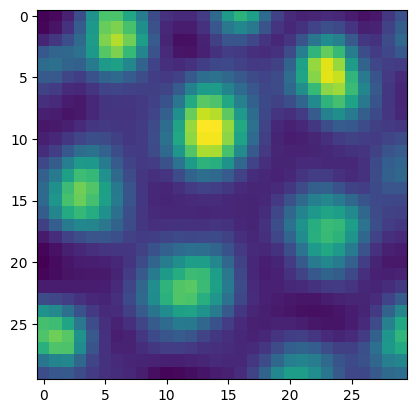

110


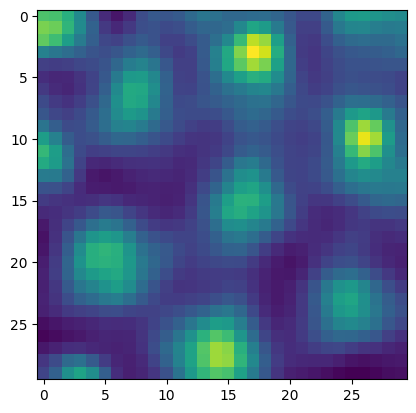

111


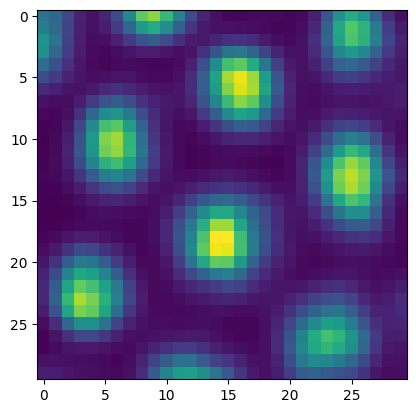

112


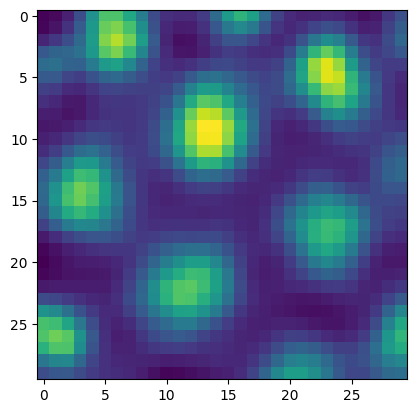

113


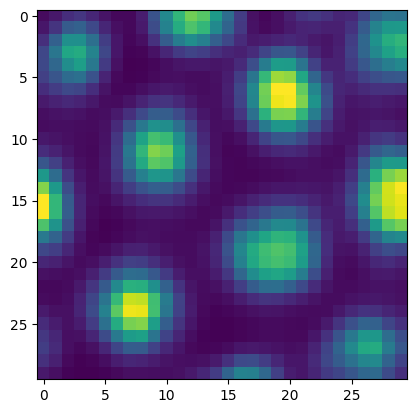

114


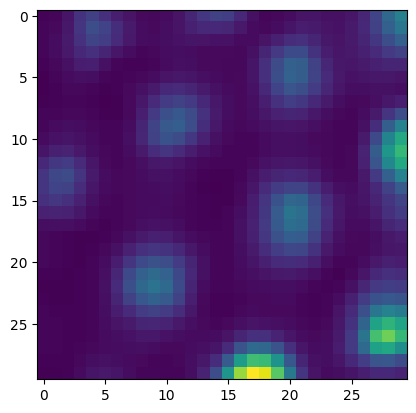

115


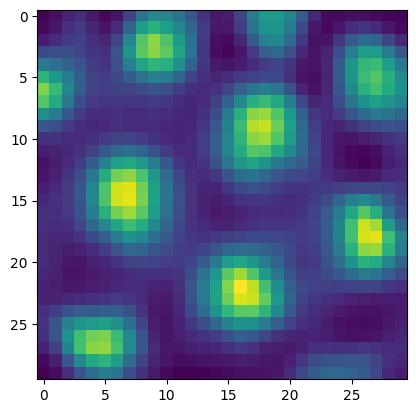

116


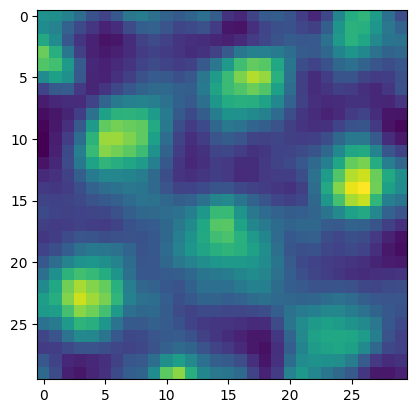

117


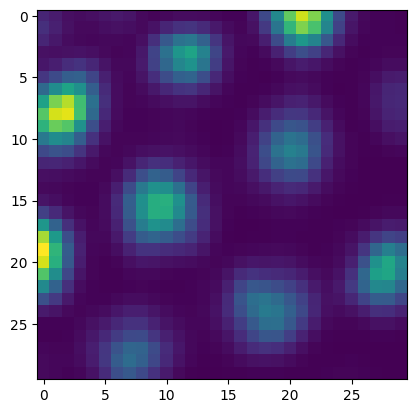

118


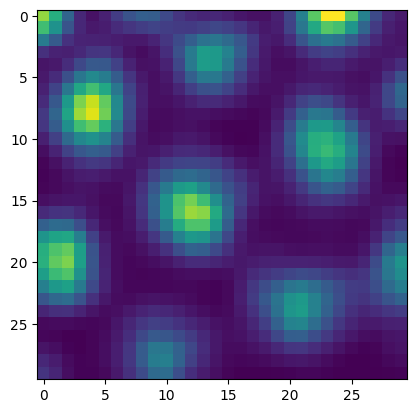

119


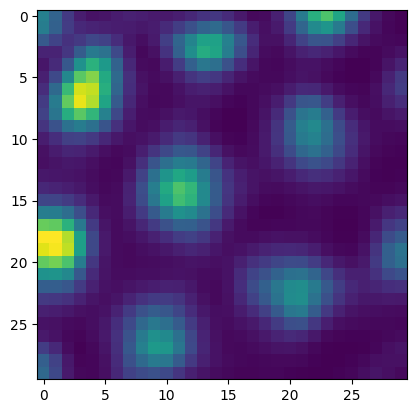

120


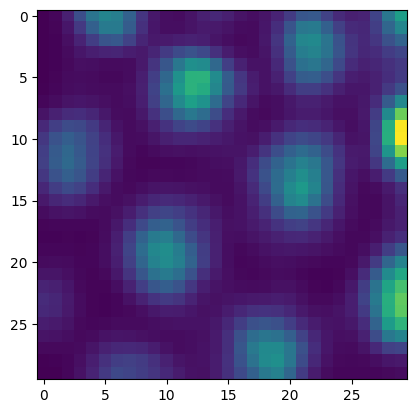

121


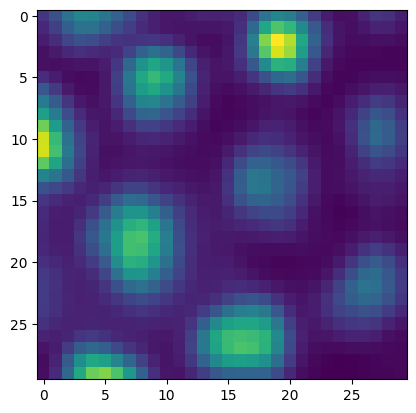

122


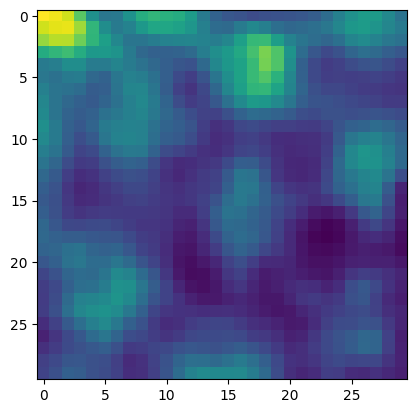

123


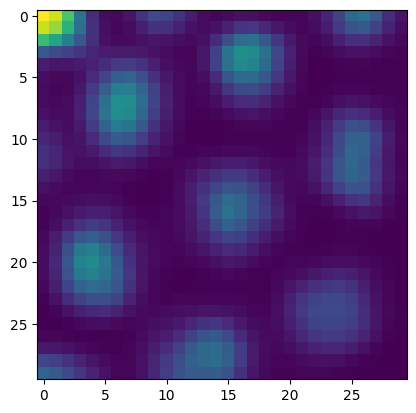

124


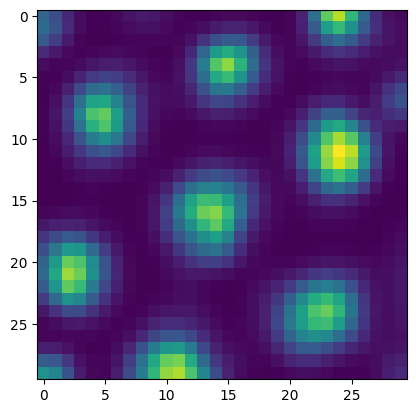

125


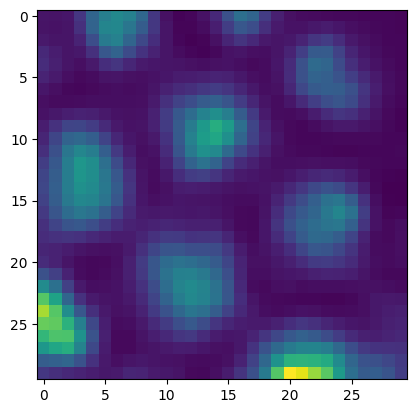

126


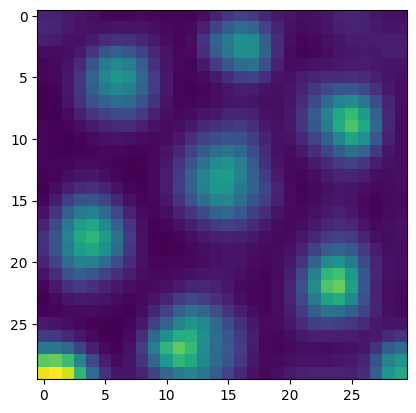

127


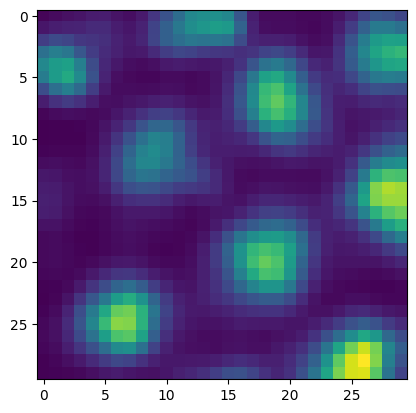

128


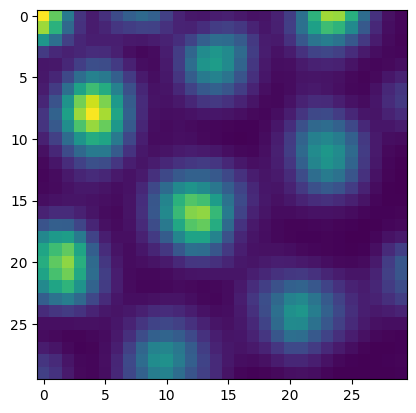

129


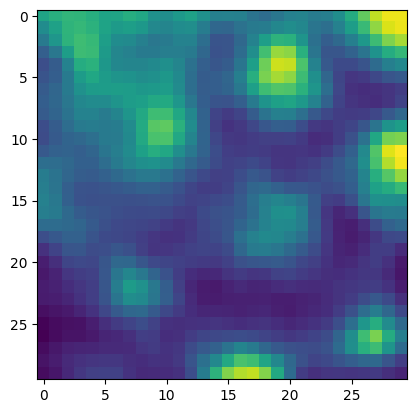

130


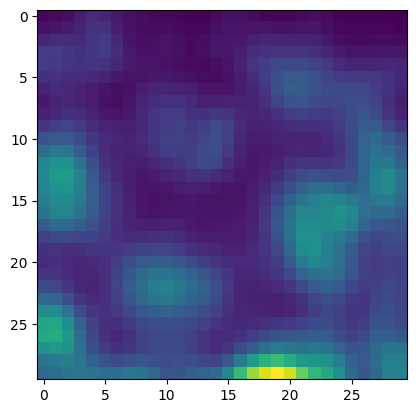

131


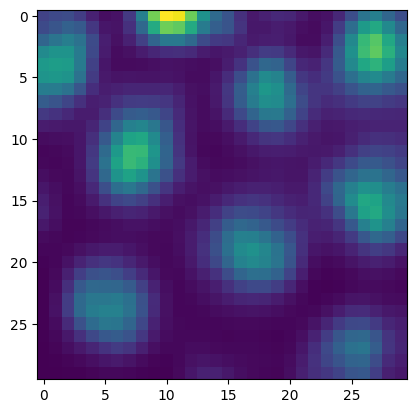

132


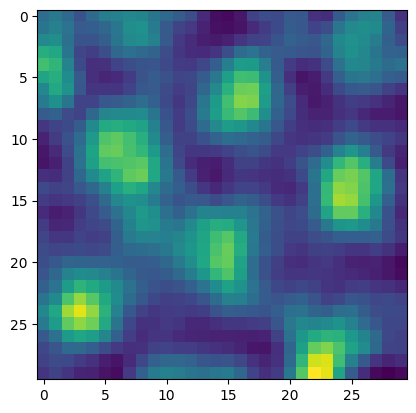

133


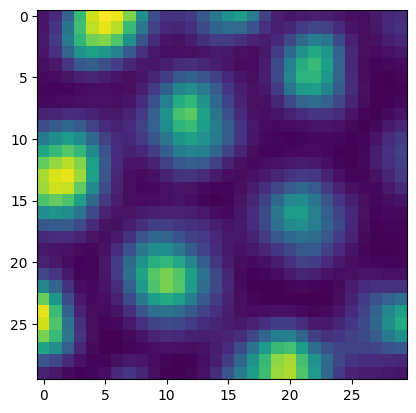

134


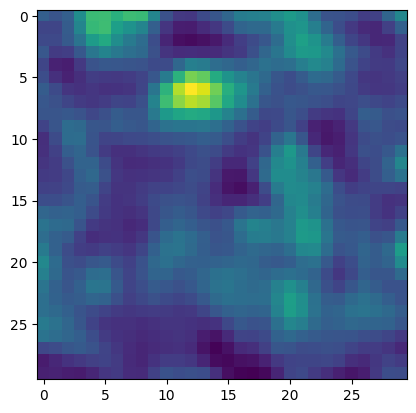

135


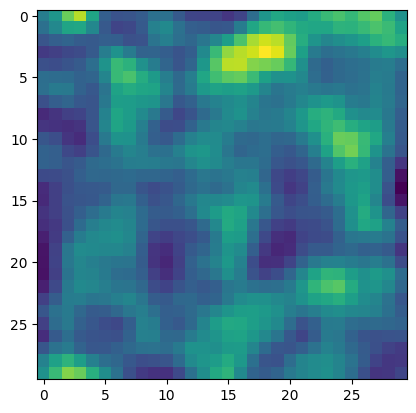

136


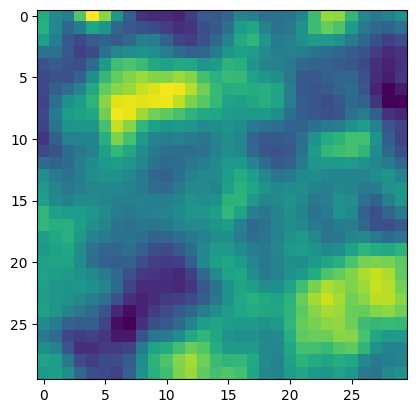

137


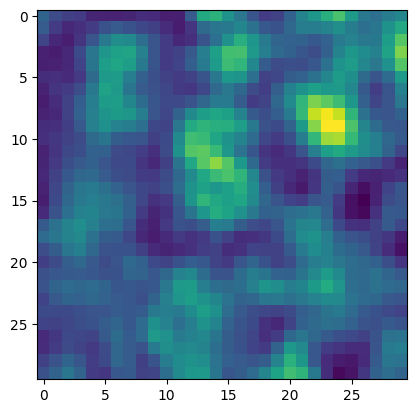

138


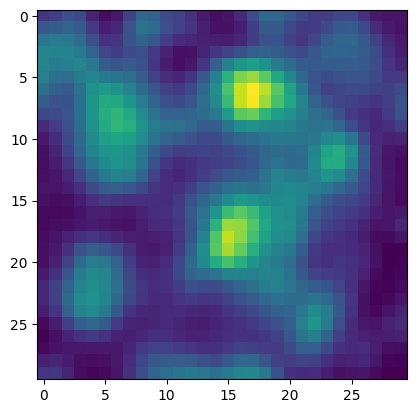

139


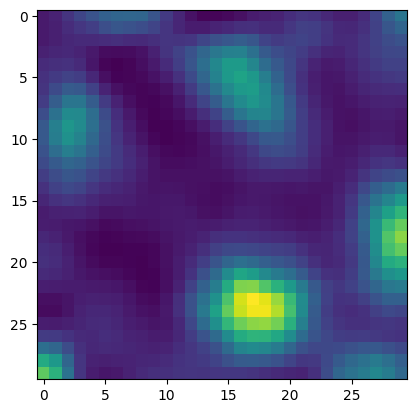

140


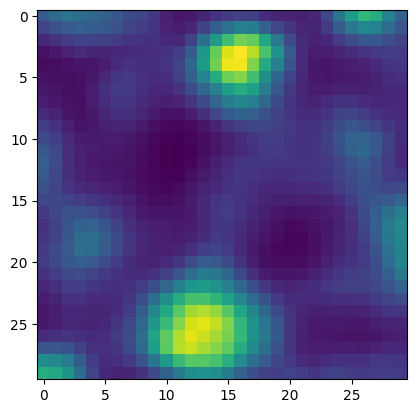

141


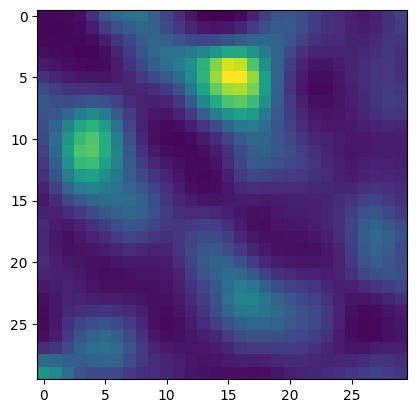

142


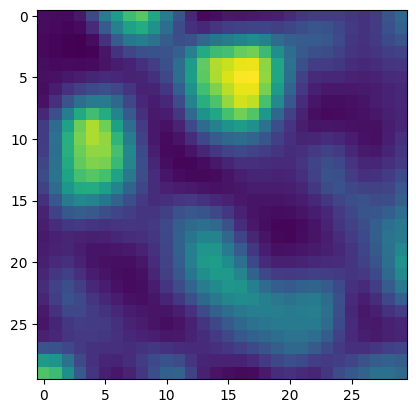

143


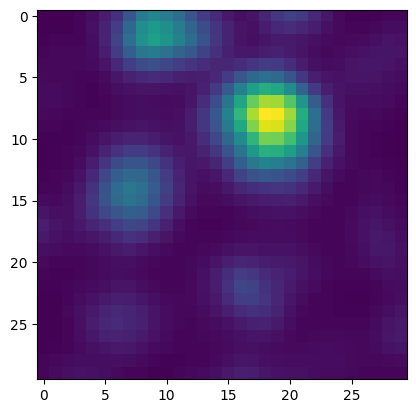

144


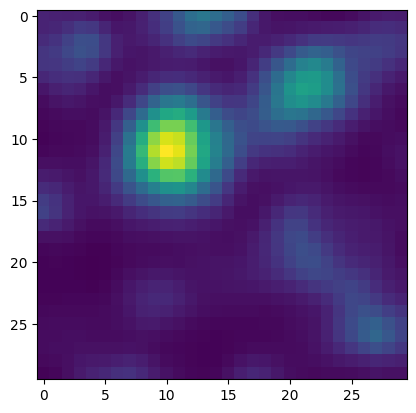

145


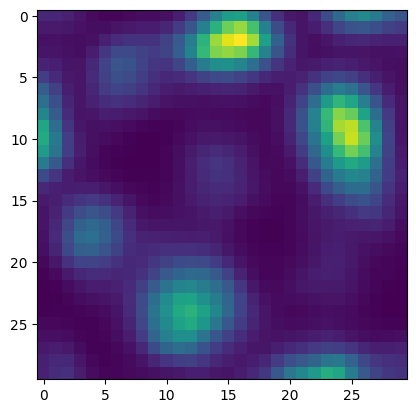

146


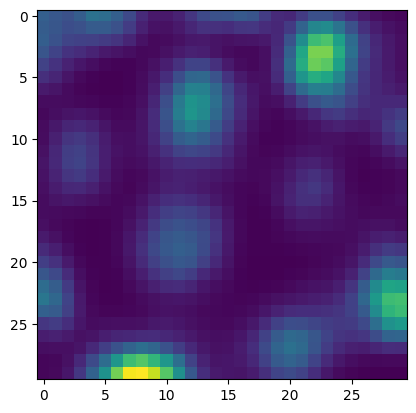

147


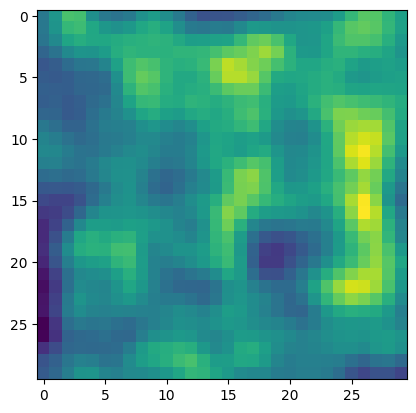

148


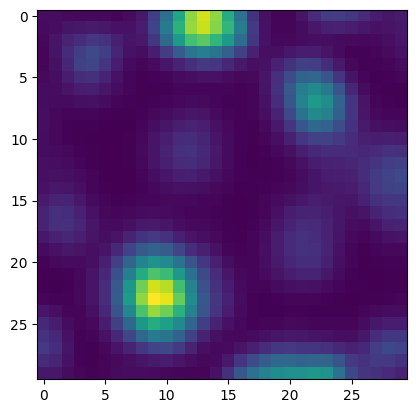

149


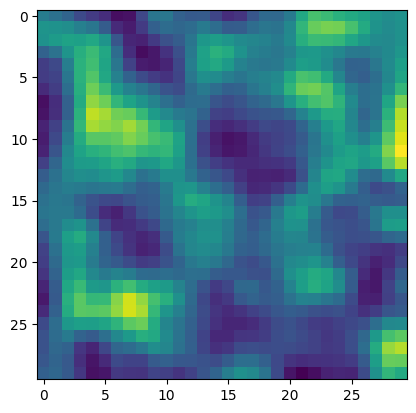

150


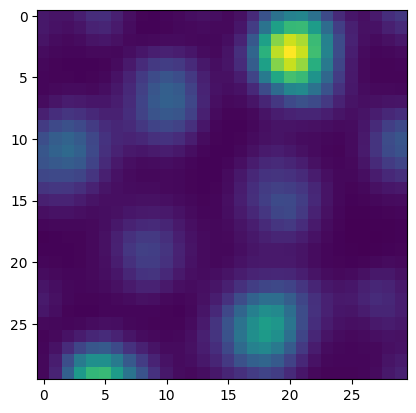

151


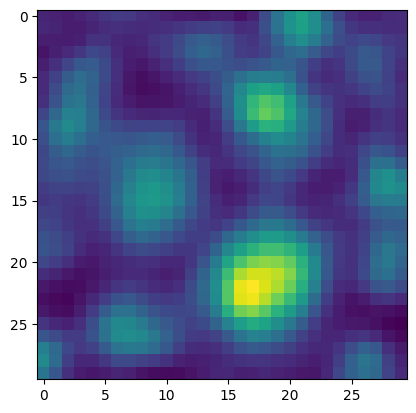

152


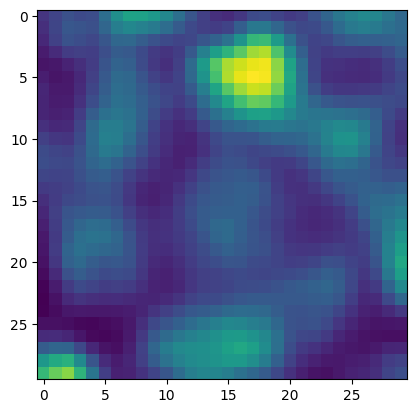

153


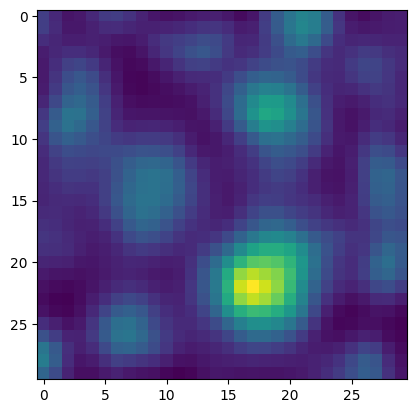

154


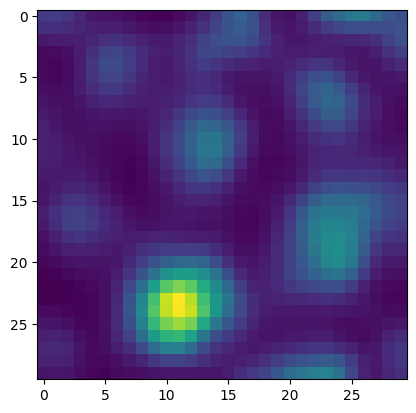

155


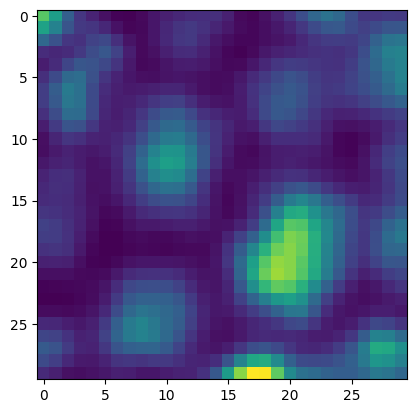

156


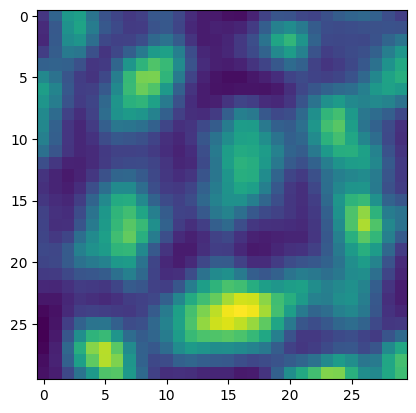

157


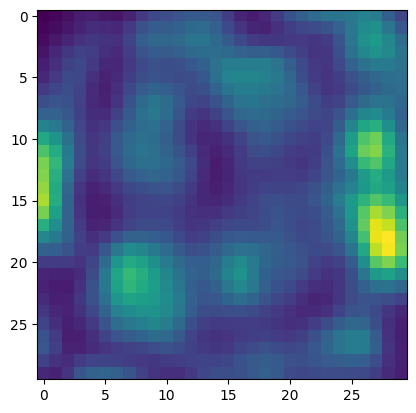

158


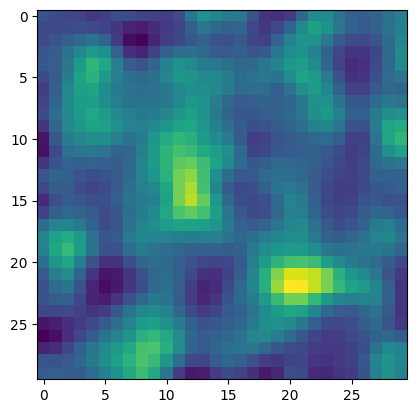

159


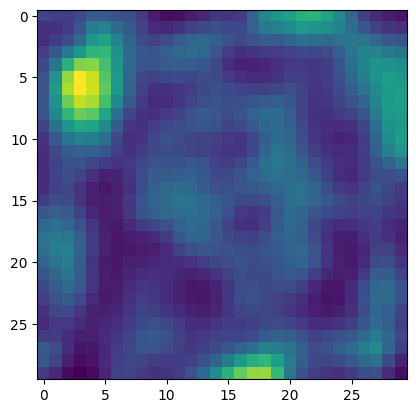

160


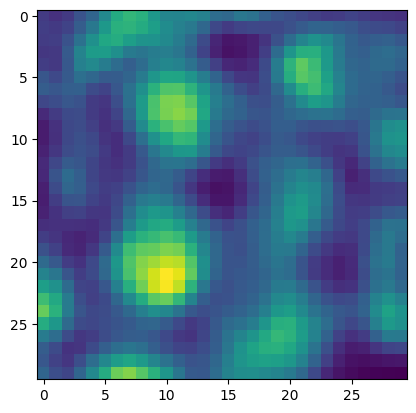

161


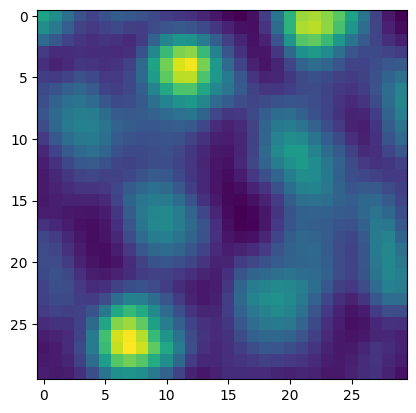

162


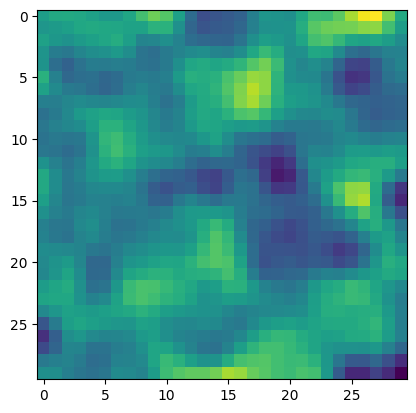

163


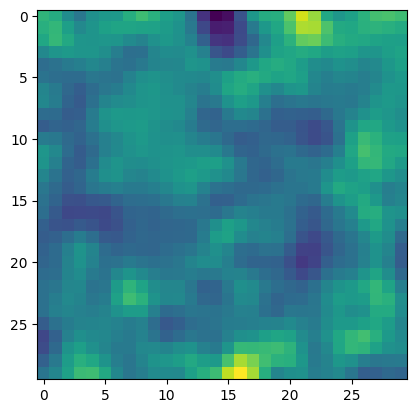

164


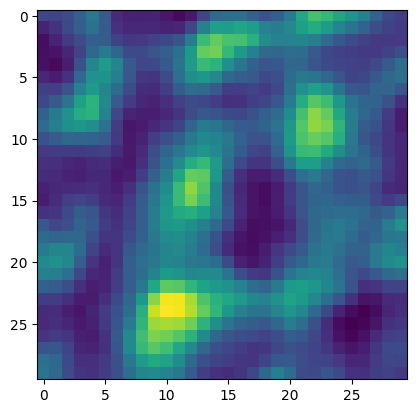

165


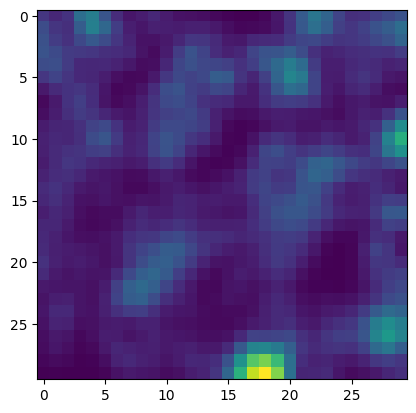

In [ ]:
n_bins = 30
l0 = -0.725
l1 = 0.725
smooth_positions = discretize(positions.T,l0, l1, n_bins, "gaussian", 1)
fire_rate_grid = {}
for cell in pos.keys():
    print(cell)
    fire_rate = discretize(pos[cell], l0, l1, n_bins, "gaussian", 1)
    fire_rate_grid[cell] = (fire_rate/smooth_positions).flatten()
    plt.figure()
    plt.imshow(fire_rate/smooth_positions)
    plt.show()



In [ ]:
# Bin spikes per cell into the time bins defined by data['t']
# Produces: `spike_counts` dict of {cell_id: int array of length len(t)} and
# `spike_counts_matrix` of shape (n_cells, len(t)) with integer values.

# Time vector and bin edges aligned to data['t'] sampling
t = data['t']
if t.ndim != 1 or t.size < 2:
    raise ValueError("data['t'] must be a 1D array with at least 2 elements")

dt = float(np.median(np.diff(t)))
# Bin edges centered around each t[k]
edges = np.concatenate((
    [t[0] - dt/2],
    0.5 * (t[:-1] + t[1:]),
    [t[-1] + dt/2]
))

# Ensure `mod` exists (per earlier cell using spikes_mod1)
try:
    mod
except NameError:
    if 'spikes_mod1' in data.files:
        mod = data['spikes_mod1'].item()
    else:
        raise NameError("`mod` not found and 'spikes_mod1' not present in data")

spike_counts = {}
for cell, s in mod.items():
    s = np.asarray(s)
    # Histogram counts per bin aligned to `t`
    counts, _ = np.histogram(s, bins=edges)
    spike_counts[cell] = counts.astype(np.int32)

# Optional: stack as a matrix for downstream models (cells x time)
cells_sorted = sorted(spike_counts.keys())
spike_counts_matrix = np.stack([spike_counts[c] for c in cells_sorted], axis=0)

print({
    'n_cells': len(cells_sorted),
    'n_time_bins': t.size,
    'matrix_shape': spike_counts_matrix.shape,
    'dtype': str(spike_counts_matrix.dtype)
})

{'n_cells': 166, 'n_time_bins': 1418299, 'matrix_shape': (166, 1418299), 'dtype': 'int32'}


In [ ]:
neural_data = spike_counts_matrix.T  # shape = (n_time_bins, n_cells)
print(neural_data.shape)

(1418299, 166)


In [ ]:
continuous_labels = positions[:len(t)]  # shape (n_time_bins, 2) si es x,y
continuous_labels = positions[:len(t), 0:1]  # shape (n_time_bins, 1)
min_len = min(len(neural_data), len(continuous_labels))

neural_data = neural_data[:min_len]
continuous_labels = continuous_labels[:min_len]


In [ ]:
split_idx = int(0.8 * min_len)

train_data = neural_data[:split_idx]
valid_data = neural_data[split_idx:]

train_continuous_label = continuous_labels[:split_idx]
valid_continuous_label = continuous_labels[split_idx:]



In [ ]:
# entrenamos el modelo --> recomendacion usar GPU la coalb
cebra_posdir3_model.fit(train_data, train_continuous_label)


pos: -0.6010 neg:  6.6979 total:  6.0970 temperature:  1.0000: 100%|██████████| 5000/5000 [04:21<00:00, 19.09it/s]


CEBRA(batch_size=512, conditional='time_delta', max_iterations=5000,
      model_architecture='offset10-model', output_dimension=3, temperature=1,
      time_offsets=10, verbose=True)

In [ ]:


# guardamos el modelo
# 5. Save the model
import os
import tempfile
from pathlib import Path
tmp_file = Path(tempfile.gettempdir(), 'cebra.pt')
cebra_posdir3_model.save(tmp_file)



In [ ]:
import torch

cebra_posdir3_model = cebra.CEBRA.load(tmp_file, weights_only=False)
cebra_posdir3_model = torch.load(tmp_file, weights_only=False)

cebra_posdir3_model = cebra.CEBRA.load(tmp_file, weights_only=False)


In [ ]:


# 6. cargamos el modelo y calculamos el embedding
cebra_posdir3_model = cebra.CEBRA.load(tmp_file, weights_only=False)
train_embedding = cebra_posdir3_model.transform(train_data)
valid_embedding = cebra_posdir3_model.transform(valid_data)




In [ ]:
# visualizacion
#import cebra.integrations.plotly

#fig = cebra.integrations.plotly.plot_embedding_interactive(train_embedding,
                                                           embedding_labels=train_continuous_label[:,0],
                                                           title = "CEBRA-Behavior Train",
                                                           markersize=2,
                                                           cmap = "rainbow")
#fig.show()

<Figure size 500x500 with 0 Axes>

In [ ]:
import numpy as np

n_points = train_embedding.shape[0]
frac = 0.3 # 10% de los puntos

idx = np.random.choice(n_points, size=int(frac * n_points), replace=False)
idx = np.arange(int((n_points*frac)))

train_embedding_sub = train_embedding[idx]
train_labels_sub = train_continuous_label[idx, 0]

# Graficar solo los puntos seleccionados
import cebra.integrations.plotly

fig = cebra.integrations.plotly.plot_embedding_interactive(
    train_embedding_sub,
    embedding_labels=train_labels_sub,
    title="CEBRA-Behavior Train (subsampled)",
    markersize=2,
    cmap="rainbow"
)
fig.show()


<Figure size 500x500 with 0 Axes>